In [1]:
# pip install plotly
# !pip install geopandas
# conda install -c plotly plotly-geo
# conda install plotly
# conda install geopandas

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from wordcloud import WordCloud

import plotly.express as px
import geopandas as gp
import plotly.figure_factory as ff
import plotly.subplots as sp
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [3]:
# Replace 'your_mapbox_token' with your actual Mapbox token
mapbox_token = 'pk.eyJ1Ijoid2ppYW4iLCJhIjoiY2xvOGMxMmF3MGNjMjJrbzYxOGR1bmZ0ciJ9.01QxWHFIfEsLjddh4wCtgA'

# Access token for Mapbox
px.set_mapbox_access_token(mapbox_token)

# Import Data

In [4]:
#Overview of the London bike sharing system.
df = pd.read_csv('AB_NYC_2019.csv')
df.head(3)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365


## Clean Data

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [6]:
# Check any missing values
df.isna().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [7]:
# drop df empty values
df2 = df.dropna()

In [8]:
# Check any missing values
df2.isna().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

In [9]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 38821 entries, 0 to 48852
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              38821 non-null  int64  
 1   name                            38821 non-null  object 
 2   host_id                         38821 non-null  int64  
 3   host_name                       38821 non-null  object 
 4   neighbourhood_group             38821 non-null  object 
 5   neighbourhood                   38821 non-null  object 
 6   latitude                        38821 non-null  float64
 7   longitude                       38821 non-null  float64
 8   room_type                       38821 non-null  object 
 9   price                           38821 non-null  int64  
 10  minimum_nights                  38821 non-null  int64  
 11  number_of_reviews               38821 non-null  int64  
 12  last_review                     38821

In [10]:
df2.duplicated().sum()

0

In [11]:
df2.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,3.882100e+04,3.882100e+04,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000,38821.000000
mean,1.810081e+07,6.424582e+07,40.728129,-73.951149,142.332526,5.869220,29.290255,1.373229,5.166611,114.886299
std,1.069372e+07,7.589752e+07,0.054991,0.046693,196.994756,17.389026,48.182900,1.680328,26.302954,129.529950
min,2.539000e+03,2.438000e+03,40.506410,-74.244420,0.000000,1.000000,1.000000,0.010000,1.000000,0.000000
25%,8.721444e+06,7.029525e+06,40.688640,-73.982460,69.000000,1.000000,3.000000,0.190000,1.000000,0.000000
50%,1.887286e+07,2.837092e+07,40.721710,-73.954810,101.000000,2.000000,9.000000,0.720000,1.000000,55.000000
75%,2.756746e+07,1.018905e+08,40.762990,-73.935020,170.000000,4.000000,33.000000,2.020000,2.000000,229.000000
max,3.645581e+07,2.738417e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [12]:
df2.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129


In [13]:
# change name to reviews
df2.rename(columns={'name':'reviews'}, inplace=True)
# change neighbourhood_group to location
df2.rename(columns={'neighbourhood_group':'location'}, inplace=True)
# change neighbourhood to area
df2.rename(columns={'neighbourhood':'area'}, inplace=True)

In [14]:
# sns.pairplot(df2)

In [15]:
df2_corr = df2.corr(numeric_only=True)

In [16]:
# # heatmap
# plt.figure(figsize=(8, 5))
# sns.heatmap(df2_corr, annot=True)
# plt.show()

## Work start here

### Map NeighboarHood group and Room Type

In [17]:
# plt.figure(figsize= (10, 6))
# sns.scatterplot(x='longitude', y='latitude', data=df2, hue='location')
# plt.title('Airbnb locations in NYC')
# plt.show()

fig = px.scatter_mapbox(df2,
                        lat=df2.latitude,
                        lon=df2.longitude,
                        hover_data=["location", "area"],
                        color="location",
                        mapbox_style="dark",
                        zoom=10,
                        height=1000,
                        width=1000)
                        
fig.show()

In [18]:
# plt.figure(figsize= (10, 6))
# sns.scatterplot(x='longitude', y='latitude', data=df2, hue='room_type')
# plt.title('Airbnb Room Type in NYC')
# plt.show()

fig = px.scatter_mapbox(df2,
                        lat=df2.latitude,
                        lon=df2.longitude,
                        hover_data=["location", "area"],
                        color="room_type",
                        zoom=10,
                        mapbox_style="dark",
                        height=1000,
                        width=1000)
                        
fig.show()

### Room Type for each Location

In [19]:
# show the unique values in neighbourhood_group
# df2['neighbourhood_group'].unique()

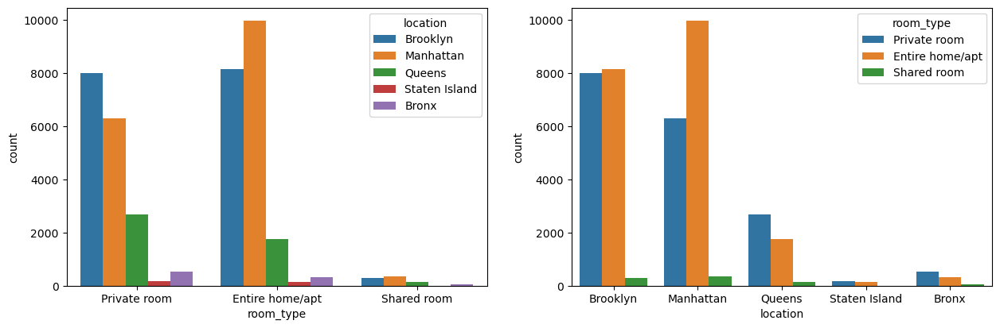

In [20]:
plt.figure(figsize= (15, 10))

plt.subplot(2, 2, 1)
sns.countplot(x='room_type', data=df2, hue='location')

plt.subplot(2, 2, 2)
sns.countplot(x='location', data=df2, hue='room_type')

plt.show()


In [21]:
df2.columns

Index(['id', 'reviews', 'host_id', 'host_name', 'location', 'area', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365'],
      dtype='object')

### Top 10 Area in NYC

In [22]:
# check neighbourhood
# df2['neighbourhood'].unique()

In [23]:
# top 10 neighbourhood in NYC
top_10_area = df2['area'].value_counts().head(10).index
top_10_area

Index(['Williamsburg', 'Bedford-Stuyvesant', 'Harlem', 'Bushwick',
       'Hell's Kitchen', 'East Village', 'Upper West Side', 'Upper East Side',
       'Crown Heights', 'Midtown'],
      dtype='object', name='area')

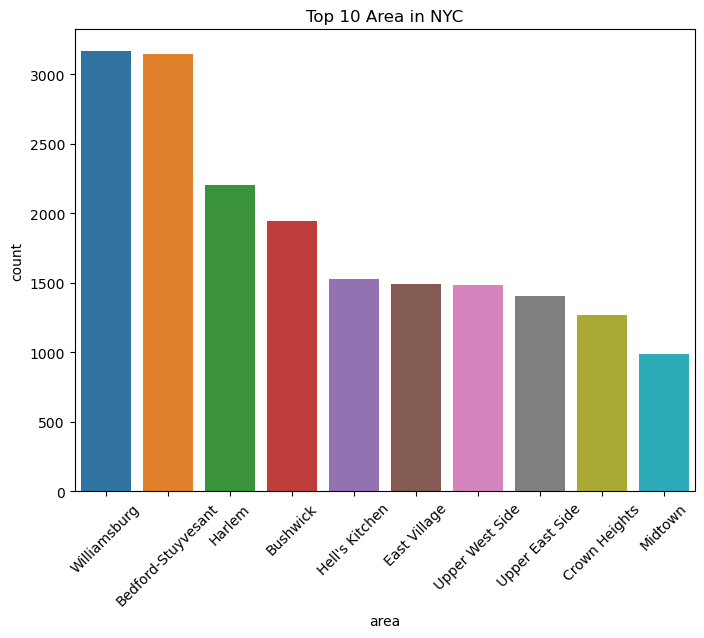

In [24]:
plt.figure(figsize= (8, 6))

sns.countplot(x='area', data= df2, order=top_10_area)
plt.xticks(rotation= 45)
plt.title('Top 10 Area in NYC')

plt.show()

### Average price of the room type

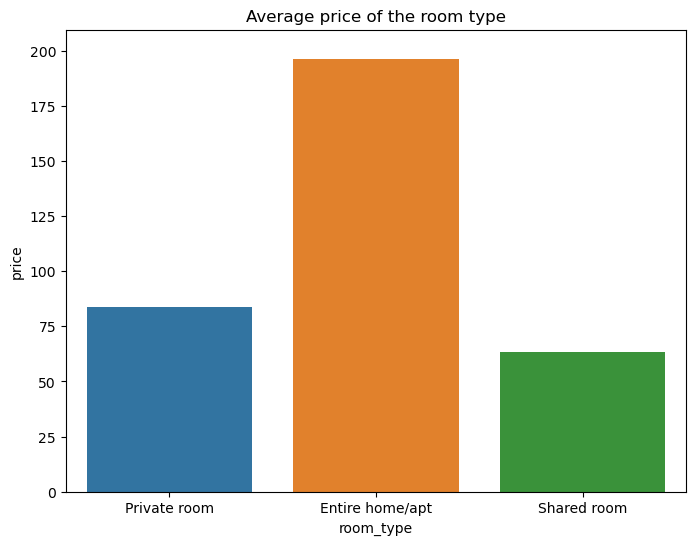

In [25]:
plt.figure(figsize= (8, 6))
sns.barplot(x='room_type', y='price', data= df2, errwidth=0)
plt.title('Average price of the room type')
plt.show()

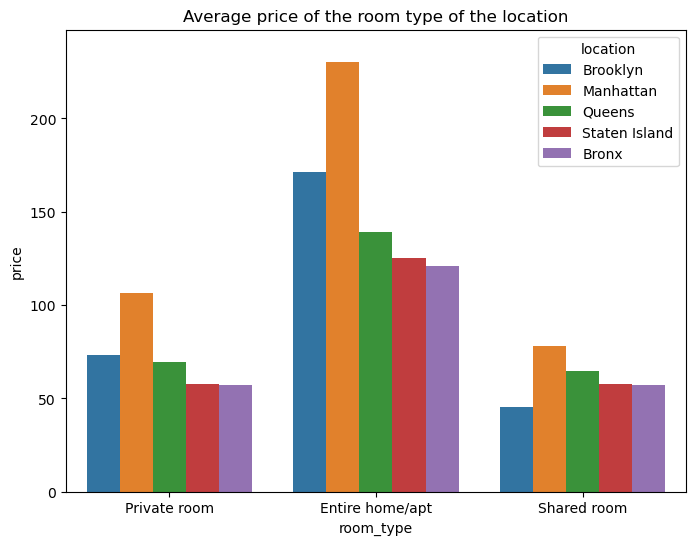

In [26]:
# Average price of the room type of the neighbourhood_group
plt.figure(figsize= (8, 6))
sns.barplot(x='room_type', y='price', data=df2, hue='location' , errwidth=0)
plt.title('Average price of the room type of the location')
plt.show()

### Top 10 expensive neighbourhood in NYC and Top 10 cheapest neighbourhood in NYC

In [27]:
top_10_expensive_area = df2.groupby('area')['price'].mean().sort_values(ascending= False).head(10)

In [28]:
print(top_10_expensive_area.index, " |||||| " ,top_10_expensive_area.values)

Index(['Sea Gate', 'Tribeca', 'NoHo', 'Flatiron District', 'SoHo', 'Neponsit',
       'Midtown', 'West Village', 'Willowbrook', 'Greenwich Village'],
      dtype='object', name='area')  ||||||  [482.5        460.3        298.4516129  291.48275862 281.30313589
 274.66666667 267.5831643  250.32622951 249.         239.12091503]


In [29]:
# plt.figure(figsize= (8, 6))
# sns.barplot(x= top_10_expensive_area.index, y= top_10_expensive_area.values)
# plt.xticks(rotation= 45)
# plt.title('Top 10 expensive neighbourhood in NYC')
# plt.show()

In [30]:
top_10_cheapest_area = df2.groupby('area')['price'].mean().sort_values().head(10)

In [31]:
# sns top_10_cheapest_area
# plt.figure(figsize= (8, 6))
# sns.barplot(x=top_10_cheapest_area.index, y= top_10_cheapest_area.values)
# plt.xticks(rotation= 45)
# plt.title('Top 10 cheapest neighbourhood in NYC')
# plt.show()

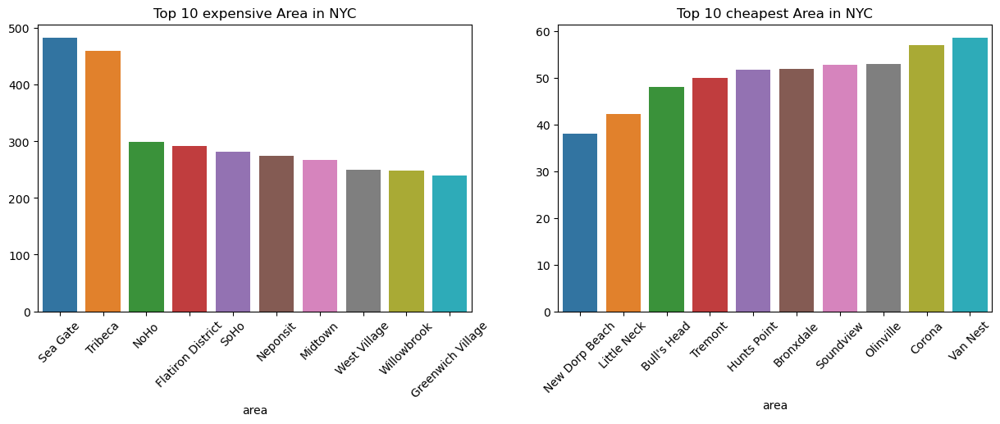

In [32]:
# subplot top 10 expensive and cheapest neighbourhood
plt.figure(figsize= (15, 10))

plt.subplot(2, 2, 1)
sns.barplot(x=top_10_expensive_area.index, y=top_10_expensive_area.values)
plt.xticks(rotation= 45)
plt.title('Top 10 expensive Area in NYC')

plt.subplot(2, 2, 2)
sns.barplot(x=top_10_cheapest_area.index, y=top_10_cheapest_area.values)
plt.xticks(rotation= 45)
plt.title('Top 10 cheapest Area in NYC')

plt.show()

- Map the price range with color

In [33]:
# craete new price categories
def price_category(price):
    if price <= 50:
        return '1-50$'
    elif price <= 100:
        return '51-100$'
    elif price <= 200:
        return '101-200$'
    elif price <= 300:
        return '201-300$'
    else:
        return '>=300$'
df2['price_category'] = df2['price'].apply(price_category)
# df['price_category']

In [34]:
# df2.head(1)

In [35]:
df2.columns

Index(['id', 'reviews', 'host_id', 'host_name', 'location', 'area', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365', 'price_category'],
      dtype='object')

In [36]:
# bar plot of the price category group by location
# plt.figure(figsize=(8, 6))
# sns.countplot(x='location', data=df2, hue='price_category')
# plt.title('Price Categories Group by Location')
# plt.show()

In [37]:
# px.set_mapbox_access_token(mapbox_token)

df = px.data.carshare()
fig = px.scatter_mapbox(df2, 
                        lat="latitude", 
                        lon="longitude", 
                        color="price", 
                        size="price", 
                        size_max=50, 
                        zoom=10, 
                        height=800, 
                        width=800
                        )

fig.show()

In [38]:
fig = px.scatter_mapbox(df2,
                        lat=df2.latitude,
                        lon=df2.longitude,
                        hover_data=["location", "area"],
                        color="price_category",
                        mapbox_style="dark",
                        zoom=10,
                        height=1000,
                        width=1000)
                        
fig.show()

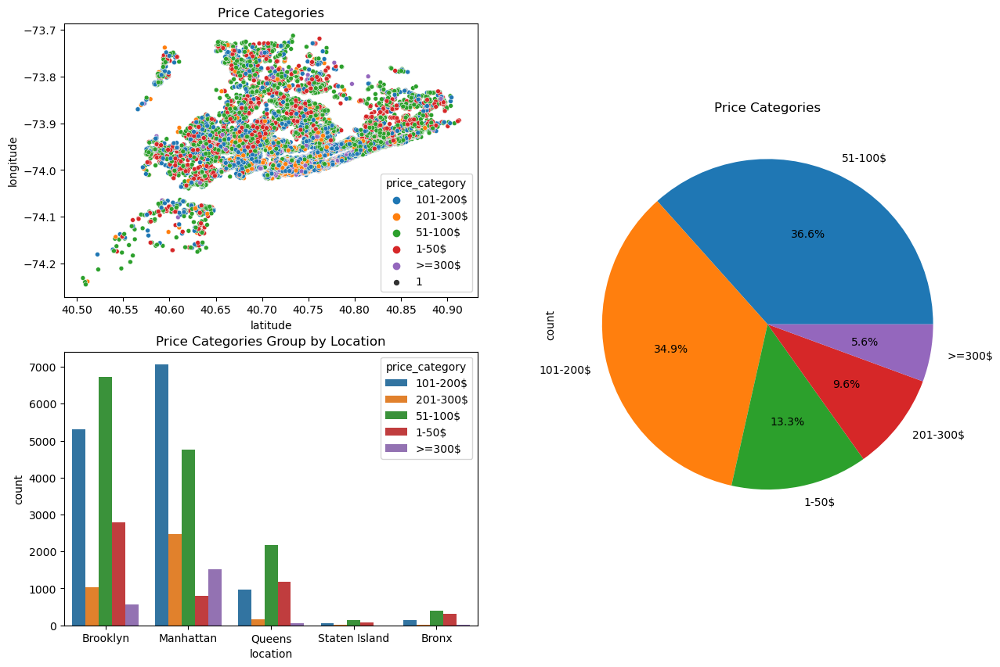

In [39]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
sns.scatterplot(x='latitude', y='longitude', hue='price_category', data=df2, size=1)
plt.title('Price Categories')

plt.subplot(1, 2, 2)
df2['price_category'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title('Price Categories')

plt.subplot(2, 2, 3)
sns.countplot(x='location', data=df2, hue='price_category')
plt.title('Price Categories Group by Location')

plt.show()


- Availbility 365

In [40]:
df2['location'].unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [41]:
df2['availability_365'].unique()

array([365, 355, 194,   0, 129, 220, 188,   6,  39, 314, 333,  46, 321,
        12,  21, 347, 364, 304, 233,  85,  75, 311,  67, 255, 284, 359,
       269, 340,  22,  96, 345, 273, 309,  95, 215, 265, 192, 251, 302,
       140, 234, 257,  30, 301, 294, 320, 154, 263, 180, 231, 297, 292,
       191,  72, 362, 336, 116,  88, 224, 322, 324, 132, 295, 238, 209,
       328,  38,   7, 272,  26, 288, 317, 207, 185, 158,   9, 198, 219,
       342, 312, 243, 152, 137, 222, 346, 208, 279, 250, 164, 298, 260,
       107, 199, 299,  20, 318, 216, 245, 189, 307, 310, 213, 278,  16,
       178, 275, 163,  34, 280,   1, 170, 214, 248, 262, 339,  10, 290,
       230,  53, 126,   3,  37, 353, 177, 246, 225,  18, 343, 326, 162,
       240, 363, 247, 323, 125,  91, 286,  60,  58, 351, 201, 232, 258,
       341, 244, 329, 253, 348,   2,  56,  68, 360,  76,  15, 226,  11,
       316, 281, 287,  14,  86, 261, 331,  51, 254, 103,  42, 249, 325,
        35, 203,   5, 276, 102,  71,  78,   8, 182,  79,  49, 15

In [42]:
# 0days , < 50 days, 50-100 days, 101-200 days, 201-300 days, > 300 days
def availability_category(availability):
    if availability <= 0:
        return 'Not Available'
    elif availability <= 50:
        return '<= 50 days'
    elif availability <= 100:
        return '51-100 days'
    elif availability <= 200:
        return '101-200 days'
    elif availability <= 300:
        return '201-300 days'
    else:
        return '> 300 days'
    
df2['availability_category'] = df2['availability_365'].apply(availability_category)

In [43]:
df2.head(1)

,id,reviews,host_id,host_name,location,area,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,availability_category
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,101-200$,> 300 days


In [44]:
df2['availability_category']

0           > 300 days
1           > 300 days
3         101-200 days
4        Not Available
5         101-200 days
             ...      
48782     101-200 days
48790       > 300 days
48799      51-100 days
48805       <= 50 days
48852       <= 50 days
Name: availability_category, Length: 38821, dtype: object

In [45]:
df2.groupby('availability_category')['location'].value_counts()


availability_category  location     
101-200 days           Manhattan        2073
                       Brooklyn         1914
                       Queens            773
                       Bronx             153
                       Staten Island      50
201-300 days           Manhattan        2039
                       Brooklyn         1895
                       Queens            535
                       Bronx              99
                       Staten Island      62
51-100 days            Brooklyn         1792
                       Manhattan        1487
                       Queens            623
                       Bronx             124
                       Staten Island      44
<= 50 days             Manhattan        2805
                       Brooklyn         2796
                       Queens            614
                       Bronx             120
                       Staten Island      24
> 300 days             Manhattan        2406
                  

In [46]:
fig = px.scatter_mapbox(df2,
                        lat=df2.latitude,
                        lon=df2.longitude,
                        hover_data=["location", "area"],
                        color="availability_category",
                        mapbox_style="dark",
                        zoom=10,
                        height=1000,
                        width=1000)
                        
fig.show()

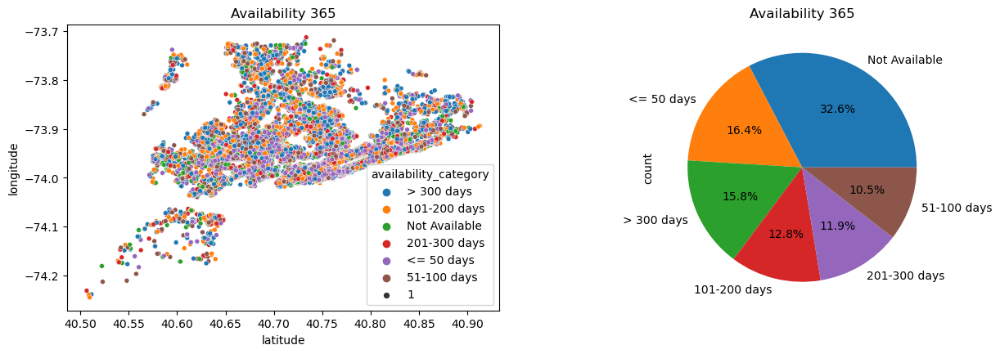

In [47]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
sns.scatterplot(x='latitude', y='longitude', hue='availability_category', data=df2, size=1)
plt.title('Availability 365')

plt.subplot(2, 2, 2)
df2['availability_category'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title('Availability 365')

plt.show()

In [48]:
# pie chart of availability category
# plt.figure(figsize=(10, 6))
# df2['availability_category'].value_counts().plot.pie(autopct='%1.1f%%')
# plt.title('Availability 365')
# plt.show()

## Get the top 10 Property by Host

- top 10 most profitable host in NYC

In [49]:
df2.columns

Index(['id', 'reviews', 'host_id', 'host_name', 'location', 'area', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365', 'price_category',
       'availability_category'],
      dtype='object')

In [50]:
top_10_host = df2.groupby('host_name')['price'].sum().sort_values(ascending= False).head(10)
top_10_host

host_name
Sonder (NYC)    55920
Michael         51313
David           48418
Jessica         40782
Alex            39116
John            34058
Amy             26133
Red Awning      24194
Daniel          24032
Andrew          23760
Name: price, dtype: int64

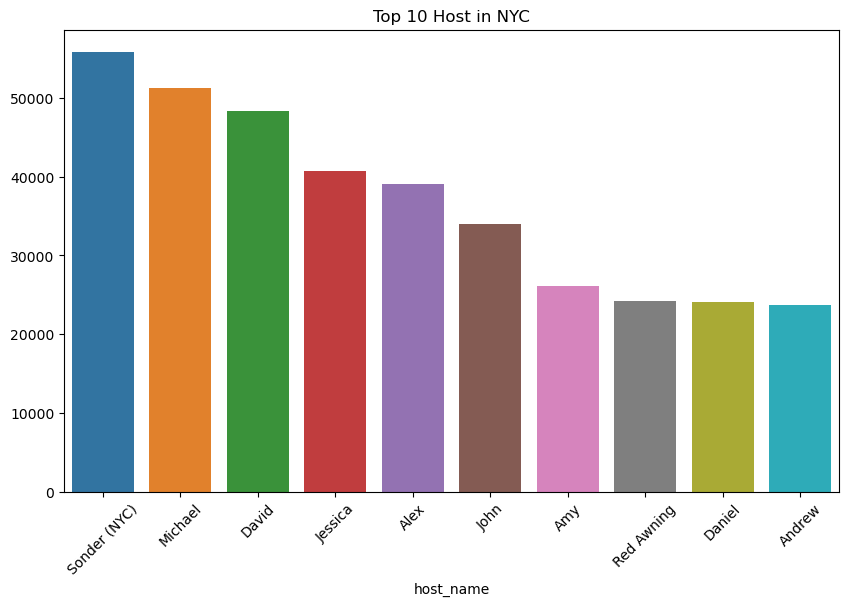

In [51]:
# use the top 10 host and show their review
plt.figure(figsize=(10, 6))
sns.barplot(x=top_10_host.index, y=top_10_host.values)
plt.xticks(rotation=45)
plt.title('Top 10 Host in NYC')
plt.show()

- top 10 host and their review

In [52]:
# top 10 host review
top_10_host_review = df2[df2['host_name'].isin(top_10_host.index)]['reviews'].value_counts()
top_10_host_review.head()

reviews
*NO GUEST SERVICE FEE* Luxury Midtown One Bedroom Suite with Kitchen    2
HOUSE WITH 2 ENTRANCES 15min TO MANHATTAN                               2
Spacious Loft 5 min to Union Square                                     2
Cozy Boerum Hill Apartment                                              2
Large cozy bedroom close to Times Square 43D4                           2
Name: count, dtype: int64

## Get top 10 area that always full booked

In [53]:
# if the available room is 0, then the room is already full booked, get the top 10 full booked room area
top_10_full_booked_room = df2[df2['availability_365'] == 0]['area'].value_counts().head(10)

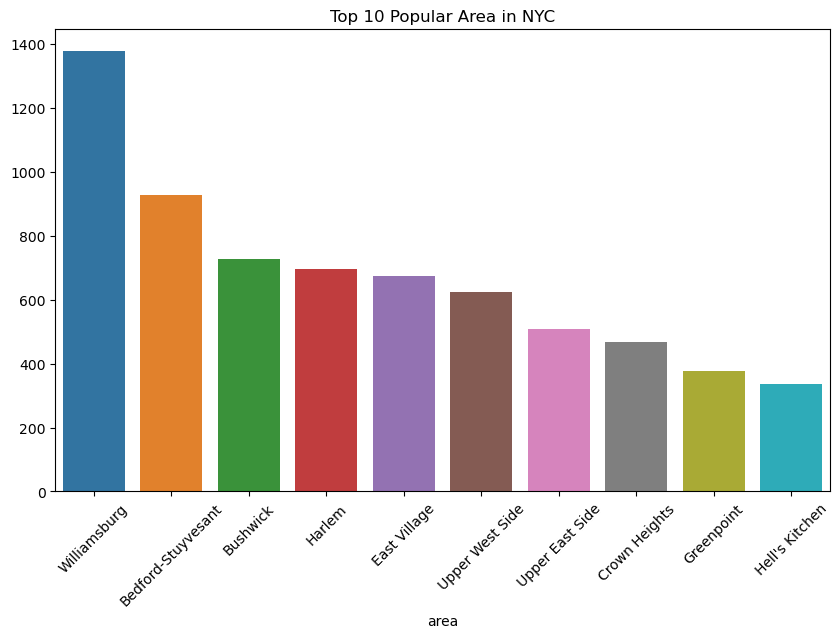

In [54]:
plt.figure(figsize=(10, 6))
sns.barplot(x=top_10_full_booked_room.index, y=top_10_full_booked_room.values)
plt.xticks(rotation=45)
plt.title('Top 10 Popular Area in NYC')
plt.show()

## Scatter plot area and price

In [55]:
# scatter plot the price closer to the top_10_full_booked_room area with price

## WordCloud Review Word

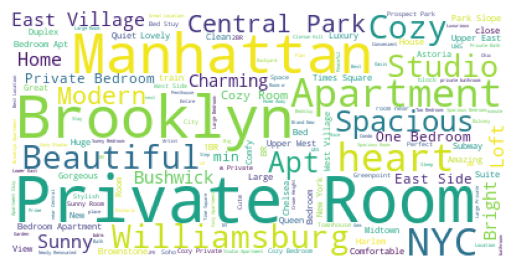

In [56]:
wc = WordCloud(background_color='white').generate(' '.join(df2['reviews']))
plt.imshow(wc)
plt.axis('off')
plt.show()

Most use word in review

### ML?

- Use Exe 29 and 30

In [57]:
df3 = df2.copy()

In [58]:
df3.isna().sum()

id                                0
reviews                           0
host_id                           0
host_name                         0
location                          0
area                              0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
price_category                    0
availability_category             0
dtype: int64

In [59]:
df3.corr(numeric_only=True)

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
id,1.000000,0.591480,-0.010085,0.103336,-0.006696,-0.073937,-0.330019,0.291786,0.098446,0.006624
host_id,0.591480,1.000000,0.012823,0.141276,0.006263,-0.051673,-0.141973,0.296274,0.149417,0.155361
latitude,-0.010085,0.012823,1.000000,0.088259,0.031344,0.024893,-0.008559,-0.010117,0.004340,-0.021921
longitude,0.103336,0.141276,0.088259,1.000000,-0.155298,-0.055414,0.054746,0.146228,-0.093348,0.102573
price,-0.006696,0.006263,0.031344,-0.155298,1.000000,0.025501,-0.035924,-0.030623,0.052895,0.078276
minimum_nights,-0.073937,-0.051673,0.024893,-0.055414,0.025501,1.000000,-0.069366,-0.121712,0.073474,0.101658
number_of_reviews,-0.330019,-0.141973,-0.008559,0.054746,-0.035924,-0.069366,1.000000,0.549699,-0.059796,0.193409
reviews_per_month,0.291786,0.296274,-0.010117,0.146228,-0.030623,-0.121712,0.549699,1.000000,-0.009442,0.185896
calculated_host_listings_count,0.098446,0.149417,0.004340,-0.093348,0.052895,0.073474,-0.059796,-0.009442,1.000000,0.182981
availability_365,0.006624,0.155361,-0.021921,0.102573,0.078276,0.101658,0.193409,0.185896,0.182981,1.000000


In [60]:
df3.head(1)

,id,reviews,host_id,host_name,location,area,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,availability_category
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,101-200$,> 300 days


## feature analysis
- pca analysis to see which the best then drop useless column


In [61]:
# drop : id	reviews	host_id	host_name area latitude	longitude (price) number_of_reviews last_review reviews_per_month
# encode : location room_type price_category availability_category
# required : minimum_nights or price

In [62]:
# ! pip install xgboost
# ! pip install lightgbm

In [63]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
from sklearn.pipeline import Pipeline
import xgboost as xgb
import lightgbm as lgb

In [64]:
df3.head(1)

,id,reviews,host_id,host_name,location,area,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_category,availability_category
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,101-200$,> 300 days


---------------------

In [65]:
df4 = df3.drop(['id','host_id','host_name','area','last_review','reviews','latitude','longitude','reviews_per_month','calculated_host_listings_count','number_of_reviews'], axis=1)

encoder = LabelEncoder()
df4['room_type'] = encoder.fit_transform(df4['room_type'])
df4['price_category'] = encoder.fit_transform(df4['price_category'])
df4['availability_category'] = encoder.fit_transform(df4['availability_category'])
df4['location'] = encoder.fit_transform(df4['location'])

In [66]:
df4.head(1)

,location,room_type,price,minimum_nights,availability_365,price_category,availability_category
0,1,1,149,1,365,1,4


- use pipeline to choose best model
- classification model

In [67]:
X = df4.drop('price', axis=1)
y = df4['price']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

regressors = {
    "Linear_Regression": LinearRegression(),
    "Decision_Tree": DecisionTreeRegressor(random_state=42),
    "Random_Forest": RandomForestRegressor(random_state=42),
    "Gradient_Boosting": GradientBoostingRegressor(random_state=42),
    'eXtreme Gradient Boosting': xgb.XGBRegressor(),
    'Light Gradient Boosting': lgb.LGBMRegressor(),
    "GaussianNB": GaussianNB(),
    "Support_Vector_Machine": SVR(),
    
}

for name, regressor in regressors.items():
    pipeline = Pipeline(
        [
            ("scaler", StandardScaler()),
            ("pca", PCA(n_components=5)),  # Check df.shape
            ("regressor", regressor),
        ]
    )

    pipeline.fit(X_train, y_train)

    y_pred = pipeline.predict(X_test)

    print(f"Results for {name}:")
    print(f"R2 score: {r2_score(y_test, y_pred)}")
    print(f"Mean squared error: {mean_squared_error(y_test, y_pred)}")
    print(f"rmse score: {np.sqrt(mean_squared_error(y_test, y_pred))}")
    print("\n" + "-" * 80 + "\n")

Results for Linear_Regression:
R2 score: 0.15161679620272628
Mean squared error: 28379.41054194842
rmse score: 168.4618964096879

--------------------------------------------------------------------------------

Results for Decision_Tree:
R2 score: 0.3229445675991326
Mean squared error: 22648.29618238414
rmse score: 150.49350877158835

--------------------------------------------------------------------------------

Results for Random_Forest:
R2 score: 0.3918461883130063
Mean squared error: 20343.456373565987
rmse score: 142.6304889340494

--------------------------------------------------------------------------------

Results for Gradient_Boosting:
R2 score: 0.3366524704013627
Mean squared error: 22189.75079917477
rmse score: 148.96224622089574

--------------------------------------------------------------------------------

Results for eXtreme Gradient Boosting:
R2 score: 0.36625949482989684
Mean squared error: 21199.361199967614
rmse score: 145.60000412076784

--------------------

In [68]:
# classification model

X = df4.drop('price', axis=1)
y = df4['price']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

model_GB = RandomForestRegressor(random_state=42)

model_GB.fit(X_train,y_train)

model_GB.feature_importances_

array([0.04697023, 0.09100638, 0.20350412, 0.23819928, 0.40484002,
       0.01547997])

In [69]:
feature_importance = pd.DataFrame(
    {"feature": list(X.columns), "importance": model_GB.feature_importances_}
).sort_values("importance", ascending=False)

In [70]:
feature_importance

,feature,importance
4,price_category,0.404840
3,availability_365,0.238199
2,minimum_nights,0.203504
1,room_type,0.091006
0,location,0.046970
5,availability_category,0.015480


In [71]:
# grid serach cv
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics # accuracy calculation

In [72]:
clf = RandomForestClassifier()

In [73]:
param_grid = {
            "criterion" : ['gini','entropy','log_loss'],
            "max_depth" : [None,5,10,15,20],
            "min_samples_split" : [2,5,10],
            "min_samples_leaf" : [1,5,10],
        }

In [74]:
grid_search = RandomizedSearchCV(
    estimator=clf,
    param_distributions=param_grid,
    scoring='accuracy',
    verbose=1,
    n_jobs=-1
)

In [75]:
grid_search.fit(X_train,y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_split.py:700: UserWarning:

The least populated class in y has only 1 members, which is less than n_splits=5.



RandomizedSearchCV(estimator=RandomForestClassifier(), n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy',
                                                      'log_loss'],
                                        'max_depth': [None, 5, 10, 15, 20],
                                        'min_samples_leaf': [1, 5, 10],
                                        'min_samples_split': [2, 5, 10]},
                   scoring='accuracy', verbose=1)

In [76]:
grid_search.best_params_

{'min_samples_split': 5,
 'min_samples_leaf': 10,
 'max_depth': 10,
 'criterion': 'gini'}

In [77]:
grid_search.best_score_

0.1497940270274277

In [78]:
# once finish grid search cv, get the best result and thn after done it
# {'min_samples_split': 10,
#  'min_samples_leaf': 1,
#  'max_depth': 10,
#  'criterion': 'gini'}

clf2 = RandomForestClassifier(
    criterion='gini',
    max_depth=10,
    min_samples_split=10,
    min_samples_leaf=1
)

In [79]:
clf2_fit = clf2.fit(X_train, y_train)

In [80]:
y_pred = clf2_fit.predict(X_test)

In [81]:
metrics.accuracy_score(y_test, y_pred)

0.15312298776561495

In [82]:
# create a dummy data to use the model to predict the price.
# price_category
# availability_365
# minimum_nights
# room_type
# location
# availability_category


dummy_data = {
    "location": [1],
    "room_type": [1],
    "minimum_nights": [1],
    "availability_365": [1],
    "price_category": [1],
    "availability_category": [1],
}

dummy_df = pd.DataFrame(dummy_data)

clf2_fit.predict(dummy_df)

array([125], dtype=int64)

--------------------------
Testing

In [84]:
# pip install smartpredict

In [90]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 38821 entries, 0 to 48852
Data columns (total 7 columns):
 #   Column                 Non-Null Count  Dtype
---  ------                 --------------  -----
 0   location               38821 non-null  int32
 1   room_type              38821 non-null  int32
 2   price                  38821 non-null  int64
 3   minimum_nights         38821 non-null  int64
 4   availability_365       38821 non-null  int64
 5   price_category         38821 non-null  int32
 6   availability_category  38821 non-null  int32
dtypes: int32(4), int64(3)
memory usage: 1.8 MB


In [96]:
# from smartpredict import SmartClassifier
# from sklearn.model_selection import train_test_split

# data = df4
# X = data.drop('price', axis=1)
# y = data['price']

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=123)

# clf = SmartClassifier(verbose=1)
# results = clf.fit(X_train, X_test, y_train, y_test)
# print(results)